KUL H02A5a Computer Vision: Group Assignment 2
---------------------------------------------------------------
Student numbers: <span style="color:red">r0999063, r0967112, r0753150, r0775439, r0967921</span>.

In this group assignment your team will delve into some deep learning applications for computer vision. The assignment will be delivered in the same groups from *Group assignment 1* and you start from this template notebook. The notebook you submit for grading is the last notebook pinned as default and submitted to the [Kaggle competition](https://www.kaggle.com/t/d11be6a431b84198bc85f54ae7e2563f) prior to the deadline on **Wednesday 22 May 23:59**. Closely follow [these instructions](https://github.com/gourie/kaggle_inclass) for joining the competition, sharing your notebook with the TAs and making a valid notebook submission to the competition. A notebook submission not only produces a *submission.csv* file that is used to calculate your competition score, it also runs the entire notebook and saves its output as if it were a report. This way it becomes an all-in-one-place document for the TAs to review. As such, please make sure that your final submission notebook is self-contained and fully documented (e.g. provide strong arguments for the design choices that you make). Most likely, this notebook format is not appropriate to run all your experiments at submission time (e.g. the training of CNNs is a memory hungry and time consuming process; due to limited Kaggle resources). It can be a good idea to distribute your code otherwise and only summarize your findings, together with your final predictions, in the submission notebook. For example, you can substitute experiments with some text and figures that you have produced "offline" (e.g. learning curves and results on your internal validation set or even the test set for different architectures, pre-processing pipelines, etc). We advise you to first go through the PDF of this assignment entirely before you really start. Then, it can be a good idea to go through this notebook and use it as your first notebook submission to the competition. You can make use of the *Group assignment 2* forum/discussion board on Toledo if you have any questions. Good luck and have fun!

---------------------------------------------------------------
NOTES:
* This notebook is just a template. Please keep the five main sections, but feel free to adjust further in any way you please!
* Clearly indicate the improvements that you make! You can for instance use subsections like: *3.1. Improvement: applying loss function f instead of g*.


# 1. Overview
This assignment consists of *three main parts* for which we expect you to provide code and extensive documentation in the notebook:
* Image classification (Sect. 2)
* Semantic segmentation (Sect. 3)
* Adversarial attacks (Sect. 4)

In the first part, you will train an end-to-end neural network for image classification. In the second part, you will do the same for semantic segmentation. For these two tasks we expect you to put a significant effort into optimizing performance and as such competing with fellow students via the Kaggle competition. In the third part, you will try to find and exploit the weaknesses of your classification and/or segmentation network. For the latter there is no competition format, but we do expect you to put significant effort in achieving good performance on the self-posed goal for that part. Finally, we ask you to reflect and produce an overall discussion with links to the lectures and "real world" computer vision (Sect. 5). It is important to note that only a small part of the grade will reflect the actual performance of your networks. However, we do expect all things to work! In general, we will evaluate the correctness of your approach and your understanding of what you have done that you demonstrate in the descriptions and discussions in the final notebook.

## 1.1 Deep learning resources
If you did not yet explore this in *Group assignment 1 (Sect. 2)*, we recommend using the TensorFlow and/or Keras library for building deep learning models. You can find a nice crash course [here](https://colab.research.google.com/drive/1UCJt8EYjlzCs1H1d1X0iDGYJsHKwu-NO).

In [1]:
import sys
import os
os.environ["SM_FRAMEWORK"] = "tf.keras"
!{sys.executable} -m pip install tensorflow
!{sys.executable} -m pip install -U segmentation-models
!{sys.executable} -m pip install -U opencv-python

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.7/1.7 MB 17.1 MB/s eta 0:00:00a 0:00:01
  Attempting uninstall: keras
    Found existing installation: keras 3.2.1
    Uninstalling keras-3.2.1:
      Successfully uninstalled keras-3.2.1
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
tensorflow-decision-forests 1.8.1 requires wurlitzer, which is not installed.
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 50.7/50.7 kB 2.9 MB/s eta 0:00:00


In [2]:
# This Python 3 environment comes with many helpful analytics libraries installed
# It is defined by the kaggle/python Docker image: https://github.com/kaggle/docker-python
import pandas as pd
import numpy as np
import tensorflow as tf
from matplotlib import pyplot as plt
import cv2, scipy
from sklearn.model_selection import train_test_split
from sklearn.model_selection import KFold
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.optimizers import RMSprop
from sklearn.utils.class_weight import compute_class_weight, compute_sample_weight
from sklearn.preprocessing import LabelEncoder
from tensorflow.random import set_seed
from glob import glob
from PIL import Image
from scipy.ndimage import map_coordinates, gaussian_filter

from skimage.transform import resize
from tensorflow.keras import datasets, layers, models, losses, Model

from tensorflow import keras
import segmentation_models as sm

2024-05-22 19:59:57.829406: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:9261] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2024-05-22 19:59:57.829525: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:607] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2024-05-22 19:59:57.948006: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1515] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered


Segmentation Models: using `tf.keras` framework.


## 1.2 PASCAL VOC 2009
For this project you will be using the [PASCAL VOC 2009](http://host.robots.ox.ac.uk/pascal/VOC/voc2009/index.html) dataset. This dataset consists of colour images of various scenes with different object classes (e.g. animal: *bird, cat, ...*; vehicle: *aeroplane, bicycle, ...*), totalling 20 classes.

The training set contains 749 examples.


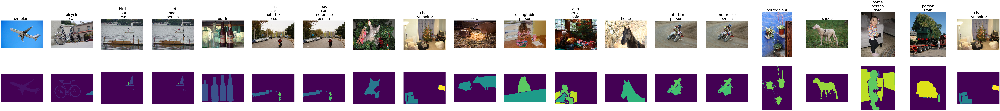

,aeroplane,bicycle,bird,boat,bottle,bus,car,cat,chair,cow,...,horse,motorbike,person,pottedplant,sheep,sofa,train,tvmonitor,img,seg
Id,,,,,,,,,,,,,,,,,,,,,
0,0,0,0,0,0,0,0,0,0,1,...,0,0,0,0,0,0,0,0,"[[[10, 8, 13], [16, 14, 19], [17, 14, 21], [19...","[[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,..."


In [3]:
# Loading the training data
train_df = pd.read_csv('//kaggle/input/kul-h02a5a-computer-vision-ga2-2024/train/train_set.csv', index_col="Id")
labels = train_df.columns
train_df["img"] = [np.load('/kaggle/input/kul-h02a5a-computer-vision-ga2-2024/train/img/train_{}.npy'.format(idx)) for idx, _ in train_df.iterrows()]
train_df["seg"] = [np.load('/kaggle/input/kul-h02a5a-computer-vision-ga2-2024/train/seg/train_{}.npy'.format(idx)) for idx, _ in train_df.iterrows()]
print("The training set contains {} examples.".format(len(train_df)))

# Show some examples
fig, axs = plt.subplots(2, 20, figsize=(10 * 20, 10 * 2))
for i, label in enumerate(labels):
    df = train_df.loc[train_df[label] == 1]
    axs[0, i].imshow(df.iloc[0]["img"], vmin=0, vmax=255)
    axs[0, i].set_title("\n".join(label for label in labels if df.iloc[0][label] == 1), fontsize=40)
    axs[0, i].axis("off")
    axs[1, i].imshow(df.iloc[0]["seg"], vmin=0, vmax=20)  # with the absolute color scale it will be clear that the arrays in the "seg" column are label maps (labels in [0, 20])
    axs[1, i].axis("off")

plt.show()

# The training dataframe contains for each image 20 columns with the ground truth classification labels and 20 column with the ground truth segmentation maps for each class
train_df.head(1)

In [4]:
# Loading the test data
test_df = pd.read_csv('/kaggle/input/kul-h02a5a-computer-vision-ga2-2024/test/test_set.csv', index_col="Id")
test_df["img"] = [np.load('/kaggle/input/kul-h02a5a-computer-vision-ga2-2024/test/img/test_{}.npy'.format(idx)) for idx, _ in test_df.iterrows()]
test_df["seg"] = [-1 * np.ones(img.shape[:2], dtype=np.int8) for img in test_df["img"]]
print("The test set contains {} examples.".format(len(test_df)))

# The test dataframe is similar to the training dataframe, but here the values are -1 --> your task is to fill in these as good as possible in Sect. 2 and Sect. 3; in Sect. 6 this dataframe is automatically transformed in the submission CSV!
test_df.head(1)

The test set contains 750 examples.


,aeroplane,bicycle,bird,boat,bottle,bus,car,cat,chair,cow,...,horse,motorbike,person,pottedplant,sheep,sofa,train,tvmonitor,img,seg
Id,,,,,,,,,,,,,,,,,,,,,
0,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,...,-1,-1,-1,-1,-1,-1,-1,-1,"[[[139, 130, 115], [136, 127, 112], [112, 102,...","[[-1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, ..."


## Augmentations

Below we implement the functionality to augment the training set. The augmentations we opted for include vetical and horizontal flips, horizontal translations, rotations and elastic deformations https://proceedings.neurips.cc/paper_files/paper/2012/file/459a4ddcb586f24efd9395aa7662bc7c-Paper.pdf . With this enriched dataset we can train models that better capture the deep features in the training set.

In [5]:
# Augmentations
def flip_horizontally(image):
    """ Flip the image horizontally """
    return np.fliplr(image)

def flip_vertically(image):
    """ Flip the image vertically """
    return np.flipud(image)

def convert_to_grayscale(image):
    """ Convert image to grayscale and retain a single color channel dimension.

    Args:
    image (np.array): Input image in RGB format.

    Returns:
    np.array: Grayscale image with shape (height, width, 1).
    """
    # Convert the image to grayscale
    gray_image = cv2.cvtColor(image, cv2.COLOR_RGB2GRAY)

    # Expand dimensions to retain the single color channel in the last axis
    gray_image = np.expand_dims(gray_image, axis=-1)

    return gray_image

def elastic_deformation(image, alpha=2, sigma=4, random_state=None):
    """
    Apply elastic deformation to an image.

    Parameters:
    - image: numpy.ndarray
        The input image to be deformed.
    - alpha: float, optional
        Scaling factor for displacement magnitude. Default is 2.
    - sigma: float, optional
        Standard deviation of the Gaussian distribution used to sample displacement vectors. Default is 4.
    - random_state: numpy.random.RandomState or int, optional
        Random state or seed for reproducible results. Default is None.

    Returns:
    - distorted_image: numpy.ndarray
        The deformed image.

    Notes:
    - This function applies elastic deformation to an image by generating random displacement vectors on a coarse grid,
      sampling displacement vectors from a Gaussian distribution, and creating a distorted image using per-pixel displacements.

    - If the input image is grayscale, a channel dimension is added before applying the deformation. The channel dimension
      is removed from the output image if the input image was originally grayscale.

    - The dimensions of the output image are the same as the input image.

    - The deformation is applied separately to each channel of the image.

    - The `map_coordinates` function used in this implementation is assumed to be imported from the `scipy.ndimage` module.

    - The `cv2` module is assumed to be imported as `cv2` for resizing the displacement vectors.

    Examples:
    >>> image = np.ones((100, 100, 3))
    >>> distorted_image = elastic_deformation(image, alpha=3, sigma=5, random_state=42)
    """
    if random_state is None:
        random_state = np.random.RandomState(None)

    if image.ndim == 2:
        image = image[..., np.newaxis]  # Handle grayscale images by adding a channel dimension

    height, width, channels = image.shape

    # Generate random displacement vectors on a coarse 3x3 grid
    grid_x, grid_y = np.meshgrid(np.linspace(0, width, 4), np.linspace(0, height, 4))

    # Displacement vectors sampled from a Gaussian distribution
    dx = random_state.normal(loc=0, scale=sigma, size=(4, 4))
    dy = random_state.normal(loc=0, scale=sigma, size=(4, 4))

    # Multiply by alpha for scaling displacement magnitude
    dx *= alpha
    dy *= alpha

    # Interpolate displacement to get smooth field
    map_x = cv2.resize(dx, (width, height), interpolation=cv2.INTER_CUBIC)
    map_y = cv2.resize(dy, (width, height), interpolation=cv2.INTER_CUBIC)  # Corrected to ensure correct dimensions

    # Create distorted image using per-pixel displacements
    distorted_image = np.zeros_like(image)
    for i in range(channels):
        coordinates_x, coordinates_y = np.meshgrid(np.arange(width), np.arange(height))
        indices_x = np.clip(coordinates_x + map_x.astype(np.float32), 0, width - 1)
        indices_y = np.clip(coordinates_y + map_y.astype(np.float32), 0, height - 1)
        distorted_image[..., i] = map_coordinates(image[..., i], [indices_y, indices_x], order=1, mode='reflect')

    if image.ndim == 2:
        distorted_image = distorted_image[..., 0]  # Remove channel dimension if originally grayscale

    return distorted_image


def shift_image(image, dx, dy):
    """ Shift the image by dx pixels in x and dy pixels in y """
    return np.roll(np.roll(image, dy, axis=0), dx, axis=1)

def rotate_image(image, angle):
    """ Rotate the image by a specified angle """
    center = (image.shape[1] // 2, image.shape[0] // 2)
    rot_mat = cv2.getRotationMatrix2D(center, angle, 1.0)
    result = cv2.warpAffine(image, rot_mat, image.shape[1::-1], flags=cv2.INTER_LINEAR)
    return result

# Apply augmentation functions to the input dataframe
def generate_augmented_dataframes(train_df):
    augmented_dataframes = []
    augmentations = [
        (flip_horizontally, 'hor_flip'),
        (flip_vertically, 'ver_flip'),
        (elastic_deformation, 'elastic'),
        (lambda img: rotate_image(img, 30), 'rotate')
    ]

    for func, name in augmentations:
        new_df = train_df.copy()
        new_df['img'] = [func(img) for img in train_df['img']]
        new_df['seg'] = [func(img) for img in train_df['seg']]
#         if name != 'gray':
#             new_df['seg'] = [func(seg) if func != convert_to_grayscale else seg for seg in train_df['seg']]
#         else:
#             new_df['seg'] = train_df['seg'].tolist()
        augmented_dataframes.append((name, new_df))

    return augmented_dataframes

augmented_dfs = generate_augmented_dataframes(train_df)
stacked_df = pd.concat([train_df] + [df for _, df in augmented_dfs])
del augmented_dfs
stacked_df.sort_index(inplace=True)

## 1.3 Your Kaggle submission
Your filled test dataframe (during Sect. 2 and Sect. 3) must be converted to a submission.csv with two rows per example (one for classification and one for segmentation) and with only a single prediction column (the multi-class/label predictions running length encoded). You don't need to edit this section. Just make sure to call this function at the right position in this notebook.

In [6]:
def _rle_encode(img):
    """
    Kaggle requires RLE encoded predictions for computation of the Dice score (https://www.kaggle.com/lifa08/run-length-encode-and-decode)

    Parameters
    ----------
    img: np.ndarray - binary img array

    Returns
    -------
    rle: String - running length encoded version of img
    """
    pixels = img.flatten()
    pixels = np.concatenate([[0], pixels, [0]])
    runs = np.where(pixels[1:] != pixels[:-1])[0] + 1
    runs[1::2] -= runs[::2]
    rle = ' '.join(str(x) for x in runs)
    return rle

def generate_submission(df):
    """
    Make sure to call this function once after you completed Sect. 2 and Sect. 3! It transforms and writes your test dataframe into a submission.csv file.

    Parameters
    ----------
    df: pd.DataFrame - filled dataframe that needs to be converted

    Returns
    -------
    submission_df: pd.DataFrame - df in submission format.
    """
    df_dict = {"Id": [], "Predicted": []}
    for idx, _ in df.iterrows():
        df_dict["Id"].append(f"{idx}_classification")
        df_dict["Predicted"].append(_rle_encode(np.array(df.loc[idx, labels])))
        df_dict["Id"].append(f"{idx}_segmentation")
        df_dict["Predicted"].append(_rle_encode(np.array([df.loc[idx, "seg"] == j + 1 for j in range(len(labels))])))

    submission_df = pd.DataFrame(data=df_dict, dtype=str).set_index("Id")
    submission_df.to_csv("submission.csv")
    return submission_df

# 2. Image classification
The goal here is simple: implement a classification CNN and train it to recognise all 20 classes (and/or background) using the training set and compete on the test set (by filling in the classification columns in the test dataframe).

In [7]:
class RandomClassificationModel:
    """
    Random classification model:
        - generates random labels for the inputs based on the class distribution observed during training
        - assumes an input can have multiple labels
    """
    def fit(self, X, y):
        """
        Adjusts the class ratio variable to the one observed in y.

        Parameters
        ----------
        X: list of arrays - n x (height x width x 3)
        y: list of arrays - n x (nb_classes)

        Returns
        -------
        self
        """
        self.distribution = np.mean(y, axis=0)
        print("Setting class distribution to:\n{}".format("\n".join(f"{label}: {p}" for label, p in zip(labels, self.distribution))))
        return self

    def predict(self, X):
        """
        Predicts for each input a label.

        Parameters
        ----------
        X: list of arrays - n x (height x width x 3)

        Returns
        -------
        y_pred: list of arrays - n x (nb_classes)
        """
        np.random.seed(0)
        return [np.array([int(np.random.rand() < p) for p in self.distribution]) for _ in X]

    def __call__(self, X):
        return self.predict(X)

model = RandomClassificationModel()
model.fit(train_df["img"], train_df[labels])
test_df.loc[:, labels] = model.predict(test_df["img"])
test_df.head(1)

Setting class distribution to:
aeroplane: 0.06275033377837116
bicycle: 0.0520694259012016
bird: 0.07343124165554073
boat: 0.06408544726301736
bottle: 0.056074766355140186
bus: 0.050734312416555405
car: 0.08411214953271028
cat: 0.06008010680907877
chair: 0.09212283044058744
cow: 0.04005340453938585
diningtable: 0.06408544726301736
dog: 0.05740987983978638
horse: 0.056074766355140186
motorbike: 0.06275033377837116
person: 0.27636849132176233
pottedplant: 0.05740987983978638
sheep: 0.036048064085447265
sofa: 0.05874499332443257
train: 0.0534045393858478
tvmonitor: 0.06809078771695594


,aeroplane,bicycle,bird,boat,bottle,bus,car,cat,chair,cow,...,horse,motorbike,person,pottedplant,sheep,sofa,train,tvmonitor,img,seg
Id,,,,,,,,,,,,,,,,,,,,,
0,0,0,0,0,0,0,0,0,0,0,...,0,0,1,0,1,0,0,0,"[[[139, 130, 115], [136, 127, 112], [112, 102,...","[[-1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, ..."


The first model we will test is made from scratch. The implementation mimics AlexNet with only 20% instead of 50% neural dropout to ensure that enough training is done on the relatively small dataset.
The design is presented below:


In [8]:
class ScratchClassifier():
    def __init__(self, num_classes, input_shape):
        N_labels = 20

        input = Input(shape =(shape,shape,3))
        x = Conv2D(filters =112, kernel_size =3, padding ='same', activation='relu')(input)
        x = BatchNormalization()(x)
        x = MaxPooling2D(2, strides=(2,2))(x)
        x = Conv2D(filters=432, kernel_size=7, padding='same', activation='relu')(x)
        x = BatchNormalization()(x)
        x = Conv2D(filters=64, kernel_size=5, padding='same', activation='relu')(x)
        x = BatchNormalization()(x)
        x = Conv2D(filters=64, kernel_size=5, padding='same', activation='relu')(x)
        x = BatchNormalization()(x)
        x = Conv2D(filters=144, kernel_size=5, padding='same', activation='relu')(x)
        x = BatchNormalization()(x)
        x = MaxPooling2D(2, strides=(2,2))
        x = Flatten()(x)
        x = Dense(1024, activation='relu')(x)
        x = Dropout(0.2)
        x = Dense(1024, activation='relu')(x)
        x = Dropout(0.2)
        x = Dense(1024, activation='relu')(x)
        x = Dense(N_labels, activation='softmax')

        self.model = Model (inputs=input, outputs =output)

        self.model.compile(optimizer=tf.keras.optimizers.Adam(learning_rate=0.001),
                      loss=tf.keras.losses.categorical_crossentropy,
                      metrics=['accuracy'])
    def fit(self, x_train, y_train, x_val, y_val, batch_size=64, epochs=40):
            history = self.model.fit(x_train, y_train, batch_size=batch_size, epochs=epochs, validation_data=(x_val, y_val))
            return history
    def predict(self,X):
            return self.model.predict(X)

    def __call__(self, X):
        return self.predict(X)


This classifier achieved a maximum accuracy on the training set of 0.1055, which is very poor. To improve upon this, we will perform pre-processing on the dataset to augment it with richer training observations and we will focus on a transfer weighted model to exploit information learned from previous classification tasks on different datasets.

## Preprocessing

The first step before classification is preprocessing the images. Since it is needed that all the training and testing need to be the same size, the images will be resized to get the same fixed image size. This is the case for the classification model that is built from scratch as well as for transfer learning. This can be easily done with the resize function from skimage.

In [9]:
def resize_img(images, img_size):
    resized_images = []
    for _,img in enumerate(images["img"].values):
        resized_images.append(resize(img, img_size))
    return np.array(resized_images)

## Transfer learning

Transfer learning is a machine learning technique where a model trained on one task is reused or adapted as a starting point for a different but related task. This approach is particularly useful when there is limited data available.

To find the best performing transfer learning model, various models from InceptionV3 to Xception and NasNet were tested. However, the best score was achieved with InceptionResNetV2. These models were originally trained on the ImageNet dataset. However, since the ImageNet dataset contains 1000 classes that are different but similar to ours, additional layers including a flatten layer and two dense layers were added. To top layer is also set to False so that the model can be trained on our image sizes and not on the predefined sizes of the model. Given the multi-class classification nature of our dataset, where an image may belong to multiple classes, we utilized a sigmoid activation function in the output layer to compute the probability of each class individually.

In [10]:
import keras.backend as K

def hamming_loss(y_true, y_pred):
    tmp = K.abs(y_true-y_pred)
    return K.mean(K.cast(K.greater(tmp,0.5),dtype=float))

class NasnetClassifier():
    def __init__(self, num_classes, input_shape):
        base_model = tf.keras.applications.NASNetLarge(weights='imagenet', include_top=False, input_shape=input_shape)
        for layer in base_model.layers:
            layer.trainable = False
        x = layers.Flatten()(base_model.output)
        x = layers.Dense(512, activation = 'relu')(x)
        x = layers.Dropout(0.3)(x)
        x = layers.Dense(512, activation = 'relu')(x)
        x = layers.Dropout(0.3)(x)
        predictions = layers.Dense(num_classes, activation='sigmoid')(x)
        self.model = Model(inputs=base_model.input, outputs = predictions)
        self.model.compile(optimizer = "adam", loss = 'binary_crossentropy', metrics=[tf.keras.metrics.BinaryAccuracy(), hamming_loss])
    def fit(self, x_train, y_train, x_val, y_val, batch_size=64, epochs=40):
            history = self.model.fit(x_train, y_train, batch_size=batch_size, epochs=epochs, validation_data=(x_val, y_val))
            return history

    def predict(self,X):
            return self.model.predict(X)

    def __call__(self, X):
        return self.predict(X)

In [11]:
import keras.backend as K

def hamming_loss(y_true, y_pred):
    tmp = K.abs(y_true-y_pred)
    return K.mean(K.cast(K.greater(tmp,0.5),dtype=float))

class XceptionClassifier2():
    def __init__(self, num_classes, input_shape):
        base_model = tf.keras.applications.Xception(weights='imagenet', include_top=False, input_shape=input_shape)
        for layer in base_model.layers:
            layer.trainable = False
        x = layers.Flatten()(base_model.output)
        x = layers.Dense(512, activation = 'relu')(x)
        x = layers.Dropout(0.2)(x)
        x = layers.Dense(512, activation = 'relu')(x)
        x = layers.Dropout(0.2)(x)
        predictions = layers.Dense(num_classes, activation='sigmoid')(x)
        self.model = Model(inputs=base_model.input, outputs = predictions)
        self.model.compile("adam", loss = 'binary_crossentropy', metrics=[tf.keras.metrics.BinaryAccuracy(), hamming_loss])
    def fit(self, x_train, y_train, x_val, y_val, batch_size=64, epochs=40):
            history = self.model.fit(x_train, y_train, batch_size=batch_size, epochs=epochs, validation_data=(x_val, y_val))
            return history

    def predict(self,X):
            return self.model.predict(X)

    def __call__(self, X):
        return self.predict(X)

In [12]:
import keras.backend as K

def hamming_loss(y_true, y_pred):
    tmp = K.abs(y_true-y_pred)
    return K.mean(K.cast(K.greater(tmp,0.5),dtype=float))

class inceptionV2Classifier():
    def __init__(self, num_classes, input_shape):
        base_model = tf.keras.applications.InceptionResNetV2(weights='imagenet', include_top=False, input_shape=input_shape)
        for layer in base_model.layers:
            layer.trainable = False
        x = layers.Flatten()(base_model.output)
        x = layers.Dense(512, activation = 'relu')(x)
        x = layers.Dropout(0.3)(x)
        x = layers.Dense(512, activation = 'relu')(x)
        x = layers.Dropout(0.3)(x)
        predictions = layers.Dense(num_classes, activation='sigmoid')(x)
        self.model = Model(inputs=base_model.input, outputs = predictions)
        self.model.compile(optimizer = "adam", loss = 'binary_crossentropy', metrics=[tf.keras.metrics.BinaryAccuracy(), hamming_loss])
    def fit(self, x_train, y_train, x_val, y_val, batch_size=64, epochs=40):
            history = self.model.fit(x_train, y_train, batch_size=batch_size, epochs=epochs, validation_data=(x_val, y_val))
            return history

    def predict(self,X):
            return self.model.predict(X)

    def load_weights(self,weights,custom_objects):
        self.model.load_weights(weights,custom_objects=custom_objects)

    def __call__(self, X):
        return self.predict(X)

To train the model the training data is split in a training and validation set. To improve the performance, data augmentation is applied to the training data, as "new images" are created to increase the small dataset. Applying data augmentation improved the model performance.


In [13]:
img_size = (200,200,3)

# split train data in train and validation
train, validation = train_test_split(train_df, shuffle=True, test_size=0.2)
augmented_df = generate_augmented_dataframes(train)
train = pd.concat([train] + [df for _, df in augmented_df])
del augmented_df
# print(train["img"].values[0].shape)

#augment training data
y_train = np.array([i for i in train[labels].values])
y_val = np.array([i for i in validation[labels].values])
x_train = resize_img(train, img_size)
x_val = resize_img(validation, img_size)

del train
del validation

To improve the model further, the model parameters were finetuned with the following adjustments:

* Dropout Layers: Dropout layers with a value of 0.2 were added after the dense layers to prevent overfitting.
* Optimizer: Different optimizers, including Adam, RMSprop, and SGD, were tested. Ultimately, Adam provided the best performance.
* Loss Function: Binary crossentropy was used as the loss function.
* Metric: Binary accuracy was used along with Hamming loss. Hamming loss measures the fraction of labels that are incorrectly predicted. It essentially counts how many times the predicted labels do not match the actual labels, which is directly relevant in a multilabel scenario where each label is a binary value.
* Hyperparameters: The image size parameter was tested, as well as the size of the dense neuron layers.


In [14]:
num_classes = labels.shape[0]
#model = inceptionV2Classifier(num_classes, img_size)
#history = model.fit(x_train, y_train, x_val, y_val, batch_size=32, epochs=30)
modelpath = '/kaggle/input/michiel-inception/MichielInception/inceptionResNetV2.h5'
#model.load_weights('/kaggle/input/michiel-inception-model/MichielInception/inceptionResNetV2.h5',custom_objects={'hamming_loss': hamming_loss}) #From training using Colab GPU
#model = tf.keras.models.load_model(modelpath,custom_objects={'hamming_loss': hamming_loss})
model = tf.keras.models.load_model(modelpath,custom_objects={'hamming_loss': hamming_loss})

The sigmoid function provides a probability for each label individually. To effectively predict the labels, a threshold must be applied to the probability scores. This threshold is set to 0.5, meaning that if the probability of a class is higher than 0.5, the image is labeled as belonging to that class.

The model was finetuned for 30 epochs to achieve a test set and validation set accuracy of 0.9946 and 0.9573 respectively, demonstrating a great improvement on the scratch model.

In [15]:
test_resized = resize_img(test_df, img_size)
y_pred = model.predict(test_resized)
test_df.loc[:, labels] = (y_pred > 0.5).astype(int)

24/24 [==============================] - 59s 2s/step


Finally, we can visualise how well the transferred classification model performs on a set of testset images:

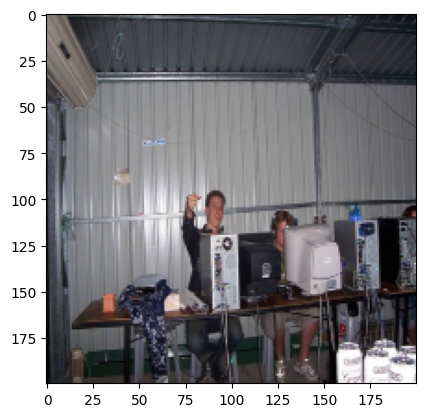

Predicted class:  chair


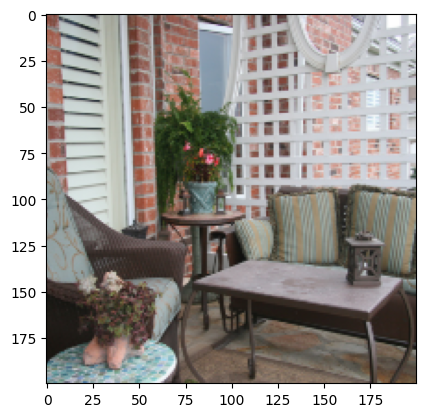

Predicted class:  chair


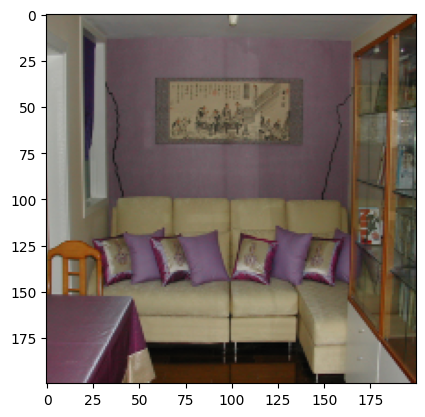

Predicted class:  sofa


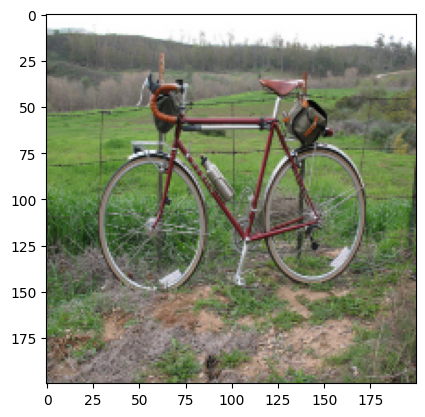

Predicted class:  bicycle


In [16]:
for i in range(4):
    plt.imshow(test_resized[i])
    plt.show()
    print("Predicted class: ",labels[np.argmax(y_pred[i])])

The model performs very well on well framed images such as the image with the bicycle, however it struggles when there is clutter, shadows and/or occlusions in the image such as in the first example. This makes sense since the key object features which have been learned from the transferred weights might be obscured in the image.

Additionaly, the model has difficulties with objects that are relatively similar like a sofa and chair, and objects that are seen together very often like tables and chairs. The problem with this is that the model will learn features that are too similar for distinguishing these items hence performs worse at classifying these instances.

# 3. Semantic segmentation
The goal here is to implement a segmentation CNN that labels every pixel in the image as belonging to one of the 20 classes (and/or background). Use the training set to train your CNN and compete on the test set (by filling in the segmentation column in the test dataframe).

## 3.1 Model from scratch

We tested two different models from scratch and we first started with a basic encoder-decoder model. First you reduce the dimesnionality Conv2D layers followed by MaxPooling2D layers and afterwards you increase the dimensionality again by using Conv2D layers followed by UpSampling2D layers. By doing this the model has to find the most important features in the input to be able to reconstruct the image as good as possible. Later we moved on to a more advanced encoder-decoder model called DeconvNet by Noh H et al. (2015). Here instead of using a UpSampling2D you use a MaxUnPool layer which instead of upsampling undoes the max pool operation. Normally this model uses a VGG16 model as backbone but we tried to create a scalled down version because the full model would take too long to train and would be hard to train with this relatively small dataset. As a loss funciton we used categorical cross-entropy as this works well for multi-class classification. We went for the adam optimizer as this showed the best results.

We performed tests with both models with changing hyperparameters and network structure but they did not yield good results, which were always being below a 0.2 iou score. This is really bad compared to transfer learning model so our main focus was on transfer learning.


Noh H, Hong S, Han B. Learning deconvolution network for semantic segmentation. InProceedings of the IEEE international conference on computer vision 2015 (pp. 1520-1528).

### 3.1.1 Basic encoder-decoder model

In [17]:
class EncoderDecoderModel:
    def __init__(self):
        self.model = Sequential()
        self.model.add(Conv2D(256, (3, 3), activation='relu', padding='same', input_shape=(224, 224, 3)))
        self.model.add(MaxPooling2D(pool_size=(2, 2)))  # Output shape: (112, 112, 256)

        self.model.add(Conv2D(128, (3, 3), activation='relu', padding='same'))
        self.model.add(MaxPooling2D(pool_size=(2, 2)))  # Output shape: (56, 56, 128)

        self.model.add(Conv2D(64, (3, 3), activation='relu', padding='same'))
        self.model.add(MaxPooling2D(pool_size=(2, 2)))  # Output shape: (28, 28, 64)

        self.model.add(Conv2D(64, (3, 3), activation='relu', padding='same'))  # Output shape: (28, 28, 64)
        self.model.add(UpSampling2D(size=(2, 2)))  # Output shape: (56, 56, 64)
        self.model.add(Conv2D(128, (3, 3), activation='relu', padding='same'))  # Output shape: (56, 56, 128)

        self.model.add(UpSampling2D(size=(2, 2)))  # Output shape: (112, 112, 128)
        self.model.add(Conv2D(256, (3, 3), activation='relu', padding='same'))  # Output shape: (112, 112, 256)

        self.model.add(UpSampling2D(size=(2, 2)))  # Output shape: (224, 224, 256)
        self.model.add(Conv2D(21, (3, 3), activation='sigmoid', padding='same'))  # Output shape: (224, 224, 21)

        self.model.compile(loss='categorical_crossentropy', optimizer='adam')

    def predict(self, image):
        return self.model.predict(np.array([image]))

    def fit(self, data, steps_per_epoch=1000, epochs=10, batch_size=32, callbacks=None):
        self.model.fit(data, steps_per_epoch=steps_per_epoch, epochs=epochs, callbacks=callbacks)

### 3.1.2 Scalled down DeconvNet

Code for this model came from: https://github.com/fabianbormann/Tensorflow-DeconvNet-Segmentation, which is written with older version of python packages so it gave some issues when trying to implement it.

In [18]:
import tensorflow as tf

from tensorflow.keras import Model, Input
from tensorflow.keras.layers import Conv2D, MaxPooling2D, Conv2DTranspose, Lambda, Layer, BatchNormalization, Activation
from tensorflow.keras import backend as K
from tensorflow.keras.models import load_model, save_model
from tensorflow.keras.applications import VGG16

import os
import random
import time
import numpy as np
import cv2

class MaxUnpoolWithArgmax(Layer):

    def __init__(self, pooling_argmax, stride = [1, 2, 2, 1], **kwargs):
        self.pooling_argmax = pooling_argmax
        self.stride = stride
        super(MaxUnpoolWithArgmax, self).__init__(**kwargs)

    def build(self, input_shape):
        super(MaxUnpoolWithArgmax, self).build(input_shape)

    def call(self, inputs):
        input_shape = K.cast(K.shape(inputs), dtype='int64')

        output_shape = (input_shape[0],
                        input_shape[1] * self.stride[1],
                        input_shape[2] * self.stride[2],
                        input_shape[3])

        argmax = self.pooling_argmax #K.stack(output_list)

        one_like_mask = K.ones_like(argmax)
        batch_range = K.reshape(K.arange(start=0, stop=input_shape[0], dtype='int64'),
                                 shape=[input_shape[0], 1, 1, 1])

        b = one_like_mask * batch_range
        y = argmax // (output_shape[2] * output_shape[3])
        x = argmax % (output_shape[2] * output_shape[3]) // output_shape[3]
        feature_range = K.arange(start=0, stop=output_shape[3], dtype='int64')
        f = one_like_mask * feature_range
        # transpose indices & reshape update values to one dimension
        updates_size = tf.size(inputs)
        indices = K.transpose(K.reshape(K.stack([b, y, x, f]), [4, updates_size]))
        values = K.reshape(inputs, [updates_size])
        return tf.scatter_nd(indices, values, output_shape)

    def compute_output_shape(self, input_shape):
        return (input_shape[0], input_shape[1] * 2, input_shape[2] * 2, input_shape[3])

    def get_config(self):
        base_config = super(MaxUnpoolWithArgmax, self).get_config()
        base_config['pooling_argmax'] = self.pooling_argmax
        base_config['stride'] = self.stride
        return base_config

    @classmethod
    def from_config(cls, config):
        return cls(**config)


class DeconvNet:
    def __init__(self, use_cpu=False, print_summary=False):
        self.build(use_cpu=use_cpu, print_summary=print_summary)


    def predict(self, image):
        return self.model.predict(np.array([image]))

    def max_pool_with_argmax(self, x):
        return tf.nn.max_pool_with_argmax(x, ksize=[1, 2, 2, 1], strides=[1, 2, 2, 1], padding='SAME')

    def fit(self, data, steps_per_epoch=1000, epochs=10, batch_size=32, callbacks=None):
        self.model.fit(data, steps_per_epoch=steps_per_epoch, epochs=epochs, callbacks=callbacks)

    def buildConv2DBlock(self, block_input, filters, block, depth):
        conv2d = Conv2D(filters, 3, padding='same', name='conv{}-{}'.format(block, i), use_bias=False)(block_input)
        conv2d = BatchNormalization(name='batchnorm{}-{}'.format(block, i))(conv2d)
        conv2d = Activation('relu', name='relu{}-{}'.format(block, i))(conv2d)
        return conv2d

    def build(self, use_cpu=False, print_summary=False):
        inputs = Input(shape=(224, 224, 3))

        conv_block_1 = self.buildConv2DBlock(inputs, 64, 1, 1)
        pool1, pool1_argmax = Lambda(self.max_pool_with_argmax, name='pool1')(conv_block_1)

        conv_block_2 = self.buildConv2DBlock(pool1, 128, 2, 1)
        pool2, pool2_argmax = Lambda(self.max_pool_with_argmax, name='pool2')(conv_block_2)

        conv_block_3 = self.buildConv2DBlock(pool2, 256, 3, 1)
        pool3, pool3_argmax = Lambda(self.max_pool_with_argmax, name='pool3')(conv_block_3)

        conv_block_4 = self.buildConv2DBlock(pool3, 512, 4, 1)
        pool4, pool4_argmax = Lambda(self.max_pool_with_argmax, name='pool4')(conv_block_4)

        conv_block_5 = self.buildConv2DBlock(pool4, 512, 5, 1)
        pool5, pool5_argmax = Lambda(self.max_pool_with_argmax, name='pool5')(conv_block_5)

        fc6 = Conv2D(512, 7, use_bias=False, padding='valid', name='fc6')(pool5) #4096
        fc6 = BatchNormalization(name='batchnorm_fc6')(fc6)
        fc6 = Activation('relu', name='relu_fc6')(fc6)

        fc7 = Conv2D(512, 1, use_bias=False, padding='valid', name='fc7')(fc6)   #4096
        fc7 = BatchNormalization(name='batchnorm_fc7')(fc7)
        fc7 = Activation('relu', name='relu_fc7')(fc7)

        x = Conv2DTranspose(512, 7, use_bias=False, padding='valid', name='deconv-fc6')(fc7)
        x = BatchNormalization(name='batchnorm_deconv-fc6')(x)
        x = Activation('relu', name='relu_deconv-fc6')(x)
        x = MaxUnpoolWithArgmax(pool5_argmax, name='unpool5')(x)
        x.set_shape(conv_block_5.get_shape())

        x = Conv2DTranspose(512, 3, use_bias=False, padding='same', name='deconv5-1')(x)
        x = BatchNormalization(name='batchnorm_deconv5-1')(x)
        x = Activation('relu', name='relu_deconv5-1')(x)

        x = MaxUnpoolWithArgmax(pool4_argmax, name='unpool4')(x)
        x.set_shape(conv_block_4.get_shape())

        x = Conv2DTranspose(512, 3, use_bias=False, padding='same', name='deconv4-1')(x)
        x = BatchNormalization(name='batchnorm_deconv4-1')(x)
        x = Activation('relu', name='relu_deconv4-1')(x)

        x = MaxUnpoolWithArgmax(pool3_argmax, name='unpool3')(x)
        x.set_shape(conv_block_3.get_shape())

        x = Conv2DTranspose(256, 3, use_bias=False, padding='same', name='deconv3-1')(x)
        x = BatchNormalization(name='batchnorm_deconv3-1')(x)
        x = Activation('relu', name='relu_deconv3-1')(x)

        x = Conv2DTranspose(128, 3, use_bias=False, padding='same', name='deconv3-3')(x)
        x = BatchNormalization(name='batchnorm_deconv3-3')(x)
        x = Activation('relu', name='relu_deconv3-3')(x)

        x = MaxUnpoolWithArgmax(pool2_argmax, name='unpool2')(x)
        x.set_shape(conv_block_2.get_shape())

        x = Conv2DTranspose(64, 3, use_bias=False, padding='same', name='deconv2-2')(x)
        x = BatchNormalization(name='batchnorm_deconv2-2')(x)
        x = Activation('relu', name='relu_deconv2-2')(x)

        x = MaxUnpoolWithArgmax(pool1_argmax, name='unpool1')(x)
        x.set_shape(conv_block_1.get_shape())

        output = Conv2DTranspose(21, 1, activation='softmax', padding='same', name='output')(x)

        self.model = Model(inputs=inputs, outputs=output)
        if print_summary:
            print(self.model.summary())

        self.model.compile(optimizer='adam',
                      loss='categorical_crossentropy',
                      metrics=['accuracy', 'mse'])

## 3.2 Model using transfer learning

Transfer learning in machine learning is the process of using information learned from one task to aid the learning process of another task. In terms of deep learning for segmentation, this presents itself as transferring learned weights and deep features from a network trained to segment a set of specific classes (eg. cats vs dogs) to a different network to segment a different set of specific classes (eg. cars vs boats). The idea is that the deep features learnt are generalisable to objects outside of the training set and thus provide useful information for general semantic segmentation.

For this application, we transferred model weights learned from the large image collection Imagenet https://www.image-net.org/.
The dataset contains thousands of images encompassing far more object classes than are in the Pascal VOC set, and was used to train the breakthrough AlexNet model. What we hope to see is that when transferring a model learnt on this much larger dataset and then fine-tuning it on our own training data, we can acheive even better performance than training the weights and network architecture from scratch.

We chose ResNet as a model backbone for transferring learned weights due to its employment of skip connections to tackle the vanishing gradient problem often presented in deep networks. This will allow for fine-tuning of the model to have some effect on the transferred deep features. It is also a shallower network than a VGG backbone so will be much faster to fine-tune.
Furthermore, ResNet has a proven track record of performing semantic segmentation on Pascal datasets: http://host.robots.ox.ac.uk:8080/leaderboard/displaylb_main.php?challengeid=11&compid=6

On top of the ResNet backbone, we also employed a UNet framework which makes use of an encoder-decoder architecture to learn features at multiple scales. This has proven to work well on small training sets such as our own and has previously been used to learn complex details in biomedical images: https://proceedings.neurips.cc/paper_files/paper/2012/file/459a4ddcb586f24efd9395aa7662bc7c-Paper.pdf .
To use the UNet model, we use OpenCV to resize the training images to size (480x320) so that the dimensions are compatible with the pooling and subsampling layers in UNet:

In [19]:
'''
These functions resize the images such that it is compatible with Unet
'''

def resize_image(image, target_shape):
    # Use OpenCV to resize the image
    resized_image = cv2.resize(image.astype('uint8'), target_shape, interpolation=cv2.INTER_LINEAR)
    return resized_image

# Function to restore an image to its original dimensions
def restore_image(original_shape, resized_image):
    # Use OpenCV to resize the image back to its original shape
    restored_image = cv2.resize(resized_image, (original_shape[1], original_shape[0]), interpolation=cv2.INTER_LINEAR)
    return restored_image

def create_and_resize_dataframe(df):
    df['image_shapes'] = df['seg'].apply(lambda arr: arr.shape)
    target_shape = (480,320)
    df['img'] = df['img'].apply(lambda arr: resize_image(arr, target_shape))
    df['seg'] = df['seg'].apply(lambda arr: resize_image(arr, target_shape))
    return df

In [20]:
trainSeg_df = create_and_resize_dataframe(stacked_df)
testSeg_df = create_and_resize_dataframe(test_df)


We also use custom Dataset and Dataloader classes which are compatible with Python's segmentation package: https://github.com/qubvel/segmentation_models

In [21]:
class Dataset:
    """CamVid Dataset. Read images, apply augmentation and preprocessing transformations.

    Args:
        images_dir (str): path to images folder
        masks_dir (str): path to segmentation masks folder
        class_values (list): values of classes to extract from segmentation mask
        augmentation (albumentations.Compose): data transfromation pipeline
            (e.g. flip, scale, etc.)
        preprocessing (albumentations.Compose): data preprocessing
            (e.g. noralization, shape manipulation, etc.)

    """

    CLASSES = ["aeroplane",
                "bicycle",
                "bird",
                "boat",
                "bottle",
                "bus",
                "car",
                "cat",
                "chair",
                "cow",
                "diningtable",
                "dog",
                "horse",
                "motorbike",
                "person",
                "pottedplant",
                "sheep",
                "sofa",
                "train",
                "tvmonitor"]

    def __init__(
            self,
            dataframe,
            classes=None,
            augmentation=None,
            preprocessing=None,
    ):
        self.images_fps =  dataframe['img'].tolist()
        self.masks_fps = dataframe['seg'].tolist()

        # convert str names to class values on masks
        self.class_values = [self.CLASSES.index(cls.lower()) for cls in classes]

        self.augmentation = augmentation
        self.preprocessing = preprocessing

        self.length = dataframe.shape[0]


    def __getitem__(self, i):

        # read data
        image = self.images_fps[i]
        #image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
        mask = self.masks_fps[i]

        # extract certain classes from mask (e.g. cars)
        masks = [(mask == v) for v in self.class_values]
        mask = np.stack(masks, axis=-1).astype('float')

        # add background if mask is not binary
        if mask.shape[-1] != 1:
            background = 1 - mask.sum(axis=-1, keepdims=True)
            mask = np.concatenate((mask, background), axis=-1)

        # apply augmentations
        if self.augmentation:
            sample = self.augmentation(image=image, mask=mask)
            image, mask = sample['image'], sample['mask']

        # apply preprocessing
        if self.preprocessing:
            sample = self.preprocessing(image=image, mask=mask)
            image, mask = sample['image'], sample['mask']

        #print(image.shape)
        return image, mask

    def __len__(self):
        return self.length

class Dataloder(keras.utils.Sequence):
    """Load data from dataset and form batches

    Args:
        dataset: instance of Dataset class for image loading and preprocessing.
        batch_size: Integet number of images in batch.
        shuffle: Boolean, if `True` shuffle image indexes each epoch.
    """

    def __init__(self, dataset, batch_size=1, shuffle=False):
        self.dataset = dataset
        self.batch_size = batch_size
        self.shuffle = shuffle
        self.indexes = np.arange(len(dataset))

        self.on_epoch_end()

    def __getitem__(self, i):

        # collect batch data
        start = i * self.batch_size
        stop = (i + 1) * self.batch_size
        data = []
        for j in range(start, stop):
            data.append(self.dataset[j])

        # transpose list of lists
        batch = [np.stack(samples, axis=0) for samples in zip(*data)]

        return batch

    def __len__(self):
        """Denotes the number of batches per epoch"""
        return len(self.indexes) // self.batch_size

    def on_epoch_end(self):
        """Callback function to shuffle indexes each epoch"""
        if self.shuffle:
            self.indexes = np.random.permutation(self.indexes)

# helper function for data visualization
def visualize(**images):
    """PLot images in one row."""
    n = len(images)
    plt.figure(figsize=(16, 5))
    for i, (name, image) in enumerate(images.items()):
        plt.subplot(1, n, i + 1)
        plt.xticks([])
        plt.yticks([])
        plt.title(' '.join(name.split('_')).title())
        plt.imshow(image)
    plt.show()

The full segmentation model that we will use is defined below:

In [22]:
BACKBONE = 'resnet34'
model = sm.Unet(BACKBONE, classes=21, activation='softmax',encoder_weights='imagenet')

85521592/85521592 [==============================] - 1s 0us/step


To train the model we use an Adam optimiser with a learning rate of 0.0001 to minimse a loss function defined as a linear combination of categorical cross entropy and dice loss. The small learning rate is employed since we are only fine-tuning the model and do not want to completely override the information from the trasnferred weights. Categorical cross entropy is the most standard loss for classifiction of pixels, however dice loss is particularly good for handling class imbalances (such as this where most of the pixels are background) and tends to produce smoother and better localised segmentations https://arxiv.org/pdf/1906.11031. A combination of the two will get the best of both worlds.

Furthermore, we train for 20 epochs using batchsizes of 32 and we monitor the performance of the model by its mean IOU score. We also segregate a random 20% of the training set as a validation set such that we can inspect the generlisation ability of the model over the epochs of learning, and to reduce the learning rate when it is detected that the learning is causing the model performance on the validation set to decrease.

In [23]:
CLASSES = ["aeroplane",
            "bicycle",
            "bird",
            "boat",
            "bottle",
            "bus",
            "car",
            "cat",
            "chair",
            "cow",
            "diningtable",
            "dog",
            "horse",
            "motorbike",
            "person",
            "pottedplant",
            "sheep",
            "sofa",
            "train",
            "tvmonitor"]

In [24]:
# Shuffle the DataFrame
train_df = train_df.sample(frac=1).reset_index(drop=True)

# Create a KFold object with 5 splits
kf = KFold(n_splits=5, shuffle=False)

folds = []
for train_index, val_index in kf.split(train_df):
    train_set = train_df.iloc[train_index]
    val_set = train_df.iloc[val_index]
    folds.append((train_set, val_set))


# Random seed for reproducibility
random_seed = 42


'''
Data pre-processing, prepare all of the data to be fed into UNet
Then model training

'''


LR = 0.0001
EPOCHS = 20
BATCHSIZE = 32
metrics = [sm.metrics.IOUScore(threshold=0.5), sm.metrics.FScore(threshold=0.5)]

validation_scores = []

train_set, val_set = folds[0]
train_dataset = Dataset(train_set,classes=CLASSES)
train_dataloader = Dataloder(train_dataset, batch_size=BATCHSIZE, shuffle=True)
val_dataset = Dataset(val_set,classes=CLASSES)
val_dataloader = Dataloder(val_dataset, batch_size=1, shuffle=False)

optim = keras.optimizers.Adam(LR)
loss = sm.losses.CategoricalCELoss() + sm.losses.DiceLoss()
model.compile(optim, loss=loss, metrics=metrics)

callbacks = [
    keras.callbacks.ModelCheckpoint('./best_model.h5', save_weights_only=True, save_best_only=True, mode='min'),
    keras.callbacks.ReduceLROnPlateau()]


'''
COMMENTED OUT FOR RUNTIME REASONS
'''


#history = model.fit(
#    train_dataloader,
#    steps_per_epoch=len(train_dataloader),
#    epochs=EPOCHS,
#    callbacks=callbacks,
#    validation_data=val_dataloader,
#    validation_steps=len(val_dataloader))

#validation_scores.append(history.history['val_iou_score'][-1])


#average_validation_score = sum(validation_scores) / len(validation_scores)
#print("Final validation IOU score: ", average_validation_score)
#model.save('my_model.keras')

'\nCOMMENTED OUT FOR RUNTIME REASONS\n'

In [25]:
new_model = sm.Unet(BACKBONE, classes=21, activation='softmax',encoder_weights='imagenet')

new_model.load_weights('/kaggle/input/jgsegmentationmodel/best_model.h5') #From training using Colab GPU

After 30 epochs of fine-tunig, a training IOU score of 0.6551 was achieved. We can also visualise some of the predicted segmentations from the training set to compare with the actual segmentations:

1/1 [==============================] - 0s 343ms/step


/tmp/ipykernel_33/1474378675.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset_train_df['predicted_seg'] = subset_train_df.apply(


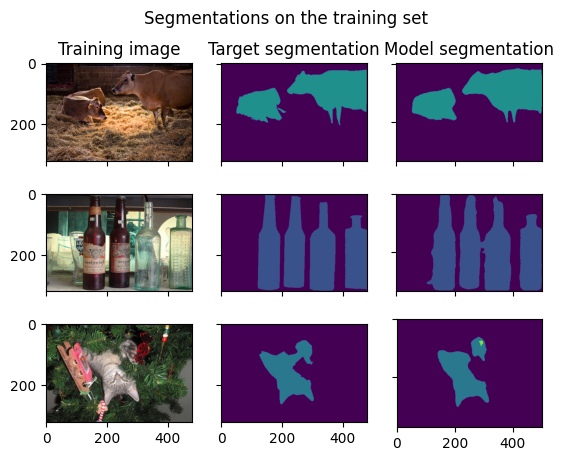

In [26]:
def predict_segmentation(image, model, target_shape):
    image0 = np.expand_dims(image, axis=0)
    pr_mask = model.predict(image0)[0]
    resized_pr_mask = restore_image(target_shape,pr_mask)
    marginalized_sum = np.argmax(resized_pr_mask, axis=2)
    return marginalized_sum

subset_train_df = trainSeg_df.head(20)

subset_train_df['predicted_seg'] = subset_train_df.apply(
    lambda row: predict_segmentation(row['img'], new_model, row['image_shapes']),
    axis=1
)

fig, ((ax1, ax2, ax3), (ax4, ax5, ax6), (ax7, ax8, ax9)) = plt.subplots(3, 3)
fig.suptitle('Segmentations on the training set')
ax1.imshow(subset_train_df.iloc[0]['img'])
ax1.set_title("Training image")
ax2.imshow(subset_train_df.iloc[0]["seg"], vmin=0, vmax=20)
ax2.set_title("Target segmentation")
ax3.imshow(subset_train_df.iloc[0]["predicted_seg"], vmin=0, vmax=20)
ax3.set_title("Model segmentation")

ax4.imshow(subset_train_df.iloc[6]['img'])
ax5.imshow(subset_train_df.iloc[6]["seg"], vmin=0, vmax=20)
ax6.imshow(subset_train_df.iloc[6]["predicted_seg"], vmin=0, vmax=20)

ax7.imshow(subset_train_df.iloc[15]['img'])
ax8.imshow(subset_train_df.iloc[15]["seg"], vmin=0, vmax=20)
ax9.imshow(subset_train_df.iloc[15]["predicted_seg"], vmin=0, vmax=20)

for ax in fig.get_axes():
    ax.label_outer()

We can clearly see that the transfer learned model replicates the training image segmentations very well, and such has been very well fine tuned to segment the training set. This suggests that the UNet with ResNet backbone is a good choice for segmenting this particular set of classes. Further improvement on the training set could be achieved with training for more epochs, however this risks overfitting the model and weaking its ability to generalise to images outside of the training set.

To assess the generalisability, we will run the model on the unlabelled test set:

In [27]:
subset_test_df = testSeg_df.head(10)

subset_test_df['seg'] = subset_test_df.apply(
    lambda row: predict_segmentation(row['img'], new_model, row['image_shapes']),
    axis=1
)

1/1 [==============================] - 0s 381ms/step


/tmp/ipykernel_33/1752776805.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset_test_df['seg'] = subset_test_df.apply(


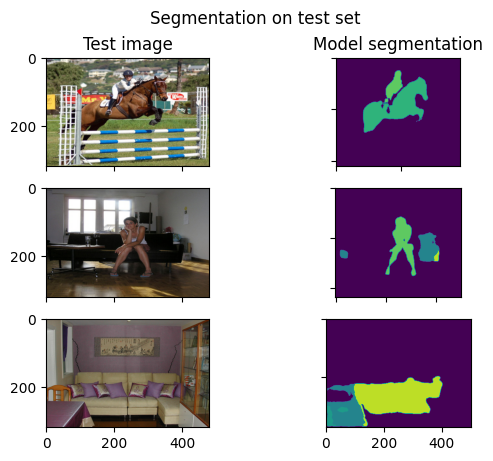

In [28]:
fig, ((ax1, ax2), (ax4, ax5), (ax7, ax8)) = plt.subplots(3, 2)
fig.suptitle('Segmentation on test set')
ax1.imshow(subset_test_df.iloc[7]['img'])
ax1.set_title("Test image")
ax2.imshow(subset_test_df.iloc[7]["seg"], vmin=0, vmax=20)
ax2.set_title("Model segmentation")

ax4.imshow(subset_test_df.iloc[4]['img'])
ax5.imshow(subset_test_df.iloc[4]["seg"], vmin=0, vmax=20)

ax7.imshow(subset_test_df.iloc[2]['img'])
ax8.imshow(subset_test_df.iloc[2]["seg"], vmin=0, vmax=20)


for ax in fig.get_axes():
    ax.label_outer()

From the above segmentations, we can see that the model is very good at identifying humans. This is likely due to the fact that the transferred weights and features were well trained on a rich dataset with images of humans.

We can also see that the model does very well at segmenting classes where there is little occlusion of the object in the image. When an object is partially obscured it can hide some of the key features that identify what makes an object.

Where the model struggles is where there are a lot of classes in close proximity within an image. Due to the dice loss during training, the model is pushed to cluster pixels into the same class such that smooth and unbroken segmentations are made.

## Submit to competition
You don't need to edit this section. Just use it at the right position in the notebook. See the definition of this function in Sect. 1.3 for more details.

In [29]:
generate_submission(test_df)

,Predicted
Id,
0_classification,9 1 15 1
0_segmentation,
1_classification,9 1 16 1
1_segmentation,
2_classification,18 1
...,...
747_segmentation,
748_classification,11 1 15 1
748_segmentation,


# 4. Adversarial attack
For this part, your goal is to fool your classification and/or segmentation CNN, using an *adversarial attack*. More specifically, the goal is build a CNN to perturb test images in a way that (i) they look unperturbed to humans; but (ii) the CNN classifies/segments these images in line with the perturbations.

Adversarial attacks on image classification models can be categorized into white-box and black-box attacks, depending on the level of access the attacker has to the model.

1. White-Box Attacks
In white-box attacks, the attacker has full knowledge of the model's architecture and parameters. This allows for more sophisticated attacks, such as the fast gradient sign method (FGSM) and its variants. FGSM is a simple yet effective method that adds noise to the input image in the direction of the gradient of the loss function with respect to the input. This noise is calculated using the sign of the gradient, hence the name.

2. Black-Box Attacks
In black-box attacks, the attacker has no knowledge of the model's architecture or parameters. These attacks are often more realistic, as an attacker may not have access to the model's internal workings. Black-box attacks can be more challenging to implement, but they are still possible using techniques such as decision-based attacks.

## DeepFool Attack

The DeepFool attack is a specific type of adversarial attack that is designed to be highly effective against image classification models. It works by iteratively adding small perturbations to the input image until the model misclassifies it. The perturbations are calculated using a linear approximation of the model's decision boundary, which makes the attack highly efficient.

The DeepFool attack is a powerful and efficient method for generating adversarial examples that can fool deep neural networks. It works by iteratively adding small perturbations to the input image until the model misclassifies it. The key idea behind DeepFool is to approximate the decision boundary of the classifier using a linear approximation. 

For a two-class classifier, the decision boundary is a hyperplane that separates the two classes. DeepFool finds the minimal perturbation required to cross this hyperplane, which corresponds to the orthogonal projection of the input onto the hyperplane. Mathematically, for a two-class classifier $f(x)$ with decision boundary $g(x) = 0$, DeepFool solves the optimization problem: 

$minimize ∥x - x₀∥₂$ $\quad$
subject to $g(x) = 0$ $\quad$
where $x₀$ is the original input. 

Due to the nonlinearity of $g(x)$, a closed-form solution is generally not possible. Instead, DeepFool uses an iterative procedure, where at each step it minimizes over the first-order approximation of 

$g(x): x^{(k+1)} = x^{(k)} - \frac{g(x^{(k)})}{∥∇g(x^{(k)})∥₂}∇g(x^{(k)})$ 

where $x^{(k)}$ is the $k-th$ iterate. This can be shown to be the projection of $x^{(k)}$ onto the hyperplane tangent to $g(x)$ at $x^{(k)}$. For multi-class classifiers, DeepFool considers the one-vs-all approach, where it solves a sequence of two-class problems. The final perturbation is the sum of the perturbations for each two-class problem. Experiments show that DeepFool generates highly effective adversarial examples that can significantly degrade the performance of deep networks. It also provides a reliable way to quantify the robustness of classifiers to adversarial perturbations.

The mathematical formulation for a multiclass classifier can be found [here](https://towardsdatascience.com/deepfool-a-simple-and-accurate-method-to-fool-deep-neural-networks-17e0d0910ac0).

In [30]:
import tensorflow as tf
from tensorflow.keras.models import load_model
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec
from PIL import Image
import os

# Load the classification model
# model = tf.keras.models.load_model('resnet50_classification.h5')

def deepfool(image, model, class_names, num_classes=20, overshoot=0.02, max_iter=50, initial_pert=1e-4, save_dir='deepfool_images'):
    """
    Implements the DeepFool attack on an image.

    Parameters:
        image (tf.Tensor): The input image tensor.
        model (tf.keras.Model): The pre-trained classification model.
        class_names (list): List of class names.
        num_classes (int): Number of classes to consider in the attack. Default is 20.
        overshoot (float): Overshoot parameter for the attack. Default is 0.02.
        max_iter (int): Maximum number of iterations for the attack. Default is 50.
        initial_pert (float): Initial perturbation value. Default is 1e-4.
        save_dir (str): Directory to save the visualizations. Default is 'deepfool_images'.

    Returns:
        r_tot (np.ndarray): Total perturbation applied.
        loop_i (int): Number of iterations taken.
        label (int): Original label of the image.
        k_i (int): Label after the attack.
        pert_image (tf.Tensor): Perturbed image tensor.
    """
    if not os.path.exists(save_dir):
        os.makedirs(save_dir)

    image = tf.convert_to_tensor(image, dtype=tf.float32)
    f_image = model(image).numpy().flatten()
    I = f_image.argsort()[::-1]
    I = I[0:num_classes]
    label = I[0]

    input_shape = image.shape[1:]  # Get the shape of the image excluding the batch dimension
    pert_image = image
    w = np.zeros(input_shape, dtype=np.float32)
    r_tot = np.zeros(input_shape, dtype=np.float32)

    loop_i = 0

    x = tf.convert_to_tensor(pert_image, dtype=tf.float32)
    fs = model(x).numpy().flatten()
    k_i = np.argmax(fs)

    while k_i == label and loop_i < max_iter:
        print(f"Iteration: {loop_i}, Perturbation: {np.linalg.norm(r_tot)}")
        pert = np.inf
        for k in range(1, num_classes):
            if k == label:
                continue
            with tf.GradientTape() as tape:
                tape.watch(x)
                fs = model(x)
                f_k = fs[0, I[k]]
                f_label = fs[0, I[label]]
                perturbation = f_k - f_label
            grad = tape.gradient(perturbation, x)
            if grad is not None:
                w_k = grad.numpy()
                f_k = f_k.numpy()
                f_label = f_label.numpy()
                pert_k = abs(f_k - f_label) / np.linalg.norm(w_k.flatten())
                if pert_k < pert:
                    pert = pert_k
                    w = w_k

        r_i = (pert + initial_pert) * w / np.linalg.norm(w)
        r_tot = r_tot + r_i
        pert_image = image + (1 + overshoot) * tf.convert_to_tensor(r_tot, dtype=tf.float32)

        x = tf.convert_to_tensor(pert_image, dtype=tf.float32)
        fs = model(x).numpy().flatten()
        k_i = np.argmax(fs)
        loop_i += 1

        # Visualize the results
        visualize_deepfool_iteration(image[0].numpy(), r_tot, pert_image[0].numpy(), model, loop_i, class_names, save_fig=True, fig_name=f"{save_dir}/deepfool_iteration_{loop_i}.png")

    r_tot = (1 + overshoot) * r_tot

    return r_tot, loop_i, label, k_i, pert_image

def visualize_deepfool_iteration(original, perturbation, perturbed, model, iteration, class_names, save_fig=False, fig_name=None):
    """
    Visualizes the DeepFool attack iteration.

    Parameters:
        original (np.ndarray): Original image.
        perturbation (np.ndarray): Perturbation applied.
        perturbed (np.ndarray): Perturbed image.
        model (tf.keras.Model): The pre-trained classification model.
        iteration (int): Current iteration number.
        class_names (list): List of class names.
        save_fig (bool): Whether to save the figure. Default is False.
        fig_name (str): File name to save the figure. Default is None.
    """
    pred_orig = model(tf.expand_dims(original, 0)).numpy().flatten()
    pred_pert = model(tf.expand_dims(perturbed, 0)).numpy().flatten()

    labels_orig = np.argsort(pred_orig)[::-1][:5]
    labels_pert = np.argsort(pred_pert)[::-1][:5]

    labels_orig_names = [f"{class_names[i]} ({pred_orig[i]*100:.2f}%)" for i in labels_orig]
    labels_pert_names = [f"{class_names[i]} ({pred_pert[i]*100:.2f}%)" for i in labels_pert]

    fig = plt.figure(figsize=(18, 6))
    gs = gridspec.GridSpec(2, 3, height_ratios=[4, 1])

    ax0 = plt.subplot(gs[0, 0])
    ax0.imshow(np.clip(original, 0, 1))
    ax0.set_title(f"Original Image", fontsize=14)
    ax0.axis('off')
    ax0_labels = plt.subplot(gs[1, 0])
    ax0_labels.text(0.5, 0.5, f"Top-5 Labels:\n{', '.join(labels_orig_names)}", ha='center', va='center', fontsize=12)
    ax0_labels.axis('off')

    ax1 = plt.subplot(gs[0, 1])
    pert_display = (perturbation - perturbation.min()) / (perturbation.max() - perturbation.min())
    ax1.imshow(np.squeeze(pert_display), cmap='viridis')
    ax1.set_title(f"Perturbation\nIteration: {iteration}\nNorm: {np.linalg.norm(perturbation):.4f}", fontsize=14)
    ax1.axis('off')
    ax1_labels = plt.subplot(gs[1, 1])
    ax1_labels.axis('off')

    ax2 = plt.subplot(gs[0, 2])
    ax2.imshow(np.clip(perturbed, 0, 1))
    ax2.set_title(f"Perturbed Image", fontsize=14)
    ax2.axis('off')
    ax2_labels = plt.subplot(gs[1, 2])
    ax2_labels.text(0.5, 0.5, f"Top-5 Labels:\n{', '.join(labels_pert_names)}", ha='center', va='center', fontsize=12)
    ax2_labels.axis('off')

    plt.tight_layout()

    if save_fig and fig_name:
        plt.savefig(fig_name, dpi=300, bbox_inches='tight')
    plt.show()

def create_collage(image_folder, collage_name):
    """
    Creates a vertical collage from saved images.

    Parameters:
        image_folder (str): Directory containing the saved images.
        collage_name (str): File name to save the collage.
    """
    image_files = [os.path.join(image_folder, file) for file in sorted(os.listdir(image_folder)) if file.endswith('.png')]
    images = [Image.open(image_file) for image_file in image_files]

    widths, heights = zip(*(i.size for i in images))

    max_width = max(widths)
    total_height = sum(heights)

    collage = Image.new('RGB', (max_width, total_height))

    y_offset = 0
    for img in images:
        collage.paste(img, (0, y_offset))
        y_offset += img.height

    collage.save(collage_name)

def preprocess_from_df(index, df, target_size):
    """
    Preprocesses data from the dataframe.

    Parameters:
        index (int): Index of the image in the dataframe.
        df (pd.DataFrame): Dataframe containing image data.
        target_size (tuple): Target size for resizing the image.

    Returns:
        tf.Tensor: Preprocessed image tensor.
    """
    image = tf.convert_to_tensor(df.iloc[index]['img'], dtype=tf.float32)
    image = tf.image.resize(image, target_size)
    image = image / 255.0  # Normalize to range [0, 1]
    return image

In [31]:
def hamming_loss(y_true, y_pred):
    """
    Calculates the Hamming loss.

    Parameters:
        y_true (tf.Tensor): Ground truth labels.
        y_pred (tf.Tensor): Predicted labels.

    Returns:
        tf.Tensor: Hamming loss value.
    """
    y_true = tf.cast(y_true, tf.float32)
    y_pred = tf.cast(y_pred, tf.float32)
    tmp = tf.math.abs(y_true - y_pred)
    return tf.reduce_mean(tf.cast(tf.greater(tmp, 0.5), dtype=tf.float32))

In [32]:
# choose model based on what works. Both are the same model - just different formats
modelpath = '/kaggle/input/rishi-attack-model/RishiAttackModel/inceptionResNetV2.h5'
#modelpath = '/kaggle/input/inception_resnet_v2_classifier/keras/classifier_custom/1/inception_resnet_v2_classifier.keras'
model = tf.keras.models.load_model(modelpath,custom_objects={'hamming_loss': hamming_loss})

Here we have 3 parameters we can tweak to get to an optimal perturbation of the decision boundary:
1. initial_pert : The initial perturbation that we begin with. *Note: Here we are beginning with a considerably large value for faster convergence.*
2. overshoot: This dictates how much the perturbation is modified with each iteration. *Note: Here we are beginning with a considerably large value for faster convergence.*
3. max_iter: The algorithm runs until the class with the highest prediction is displaced by a different one.

With low initial_pert and overshoot the perturbations will remain minimal but might take more iterations.
With higher value for these parameters, the loop stops quite early but we do get unnecessarily high perturbations.

Iteration: 0, Perturbation: 0.0


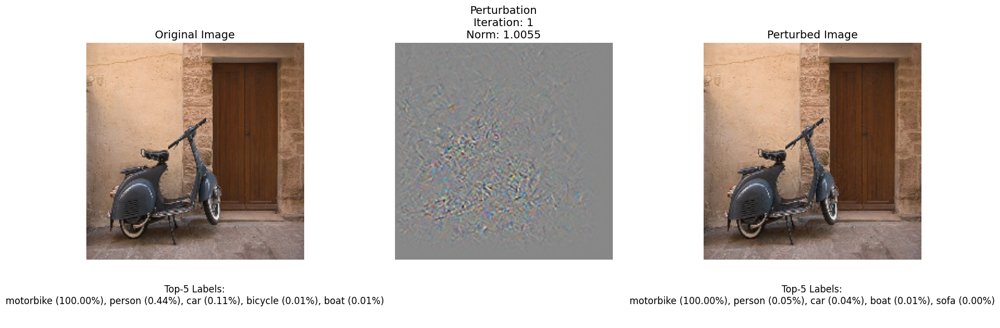

Iteration: 1, Perturbation: 1.0055358409881592


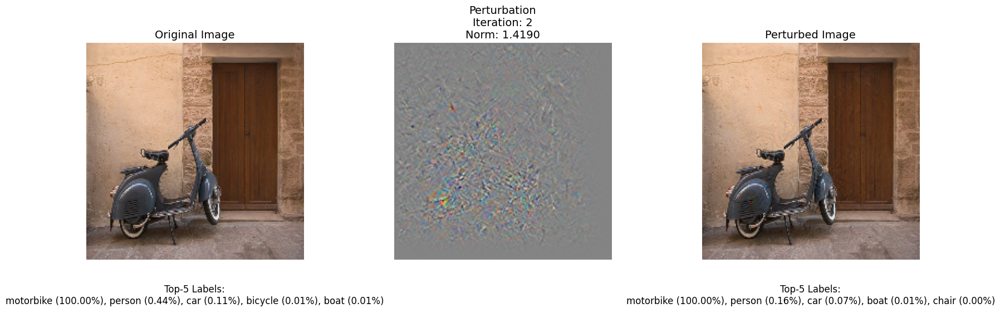

Iteration: 2, Perturbation: 1.418958306312561


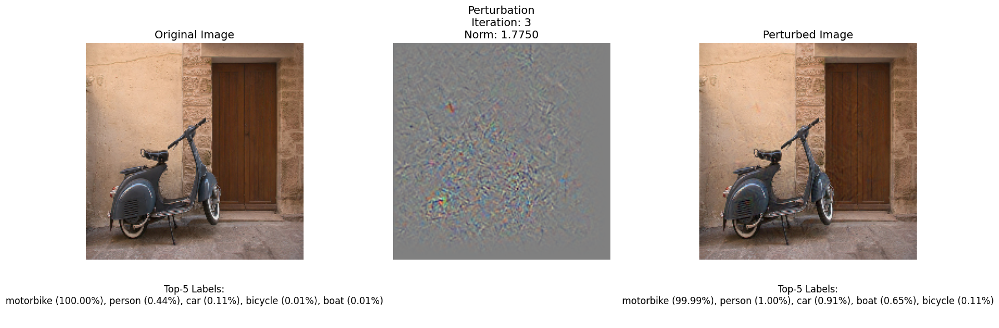

Iteration: 3, Perturbation: 1.7750422954559326


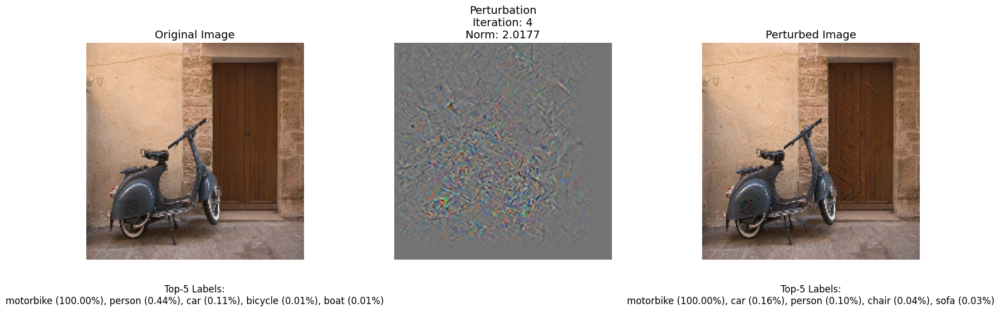

Iteration: 4, Perturbation: 2.0177223682403564


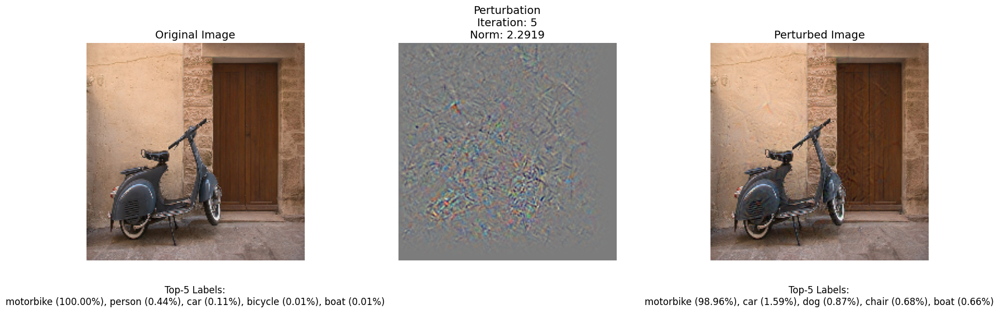

Iteration: 5, Perturbation: 2.291940450668335


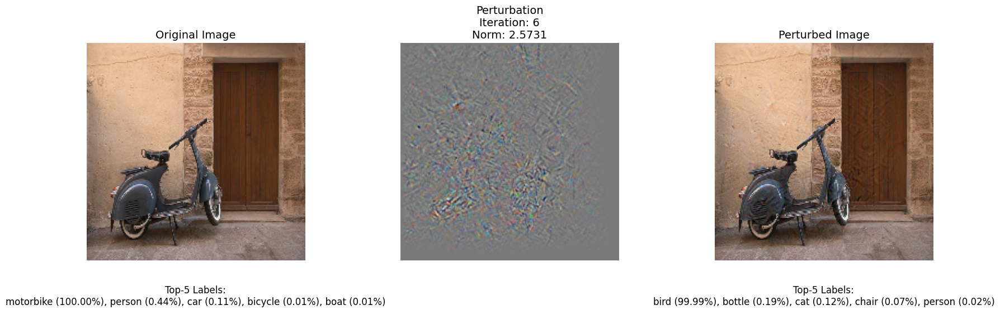

Original label: motorbike, New label: bird, Iterations: 6


In [33]:
df = train_df
target_size = (200, 200)
class_names = df.columns[:20].tolist()  # Get class names from the dataframe



# Select an example image from the dataframe
example_index = 35
example_image = preprocess_from_df(example_index, df, target_size)

# Apply DeepFool attack and visualize
perturbation, loop_i, original_label, new_label, adversarial_image = deepfool(
    tf.expand_dims(example_image, 0), model, class_names, overshoot=0.95, max_iter=100, initial_pert=1e-0, save_dir='deepfool_images'
)

print(f"Original label: {class_names[original_label]}, New label: {class_names[new_label]}, Iterations: {loop_i}")

# Create collage from saved images
create_collage('deepfool_images', 'deepfool_collage.png')

In the above example we see a case of high values for ***initial_pert*** and ***overshoot*** which stops after 6 iterations.

In [ ]:
# Select an example image from the dataframe
example_index = 46
example_image = preprocess_from_df(example_index, df, target_size)

# Apply DeepFool attack and visualize
perturbation, loop_i, original_label, new_label, adversarial_image = deepfool(
    tf.expand_dims(example_image, 0), model, class_names, overshoot=0.50, max_iter=100, initial_pert=1e-0, save_dir='deepfool_images'
)

print(f"Original label: {class_names[original_label]}, New label: {class_names[new_label]}, Iterations: {loop_i}")

# Create collage from saved images
create_collage('deepfool_images', 'deepfool_collage.png')

In the above example we see a case of high value for ***initial_pert*** but a lower value for ***overshoot*** which stops after 1 iteration. Although, this highlights a case where an image with muliple classes whose decision boundaries are more troublesome for the attack to understand.

In [ ]:
# Select an example image from the dataframe
example_index = 53
example_image = preprocess_from_df(example_index, df, target_size)

# Apply DeepFool attack and visualize
perturbation, loop_i, original_label, new_label, adversarial_image = deepfool(
    tf.expand_dims(example_image, 0), model, class_names, overshoot=0.95, max_iter=100, initial_pert=1e-1, save_dir='deepfool_images'
)

print(f"Original label: {class_names[original_label]}, New label: {class_names[new_label]}, Iterations: {loop_i}")

# Create collage from saved images
create_collage('deepfool_images', 'deepfool_collage.png')

In the above example we see a case of low value for ***initial_pert*** but a relatively higher value for ***overshoot*** which stops after 11 iterations. Here the perturbation can be seen to be relatively low.

# 5. Discussion
Finally, take some time to reflect on what you have learned during this assignment. Reflect and produce an overall discussion with links to the lectures and "real world" computer vision.

### Introductory thoughts

The key tasks we dealt with here were to build a classification and segmentation model which performs well on the subset of the PascalVOC 2009 dataset that we had at hand as well as test its performance against adversarial attacks. One good aspect about testing on a well documented dataset was that there exists a large body of literature and models which have been tried and tested on similar if not the same datasets that we could take inspiration from.
We spent significantly more time performing exploratory data analysis on the training and test sets before training any models to help us with our model/optimisation selections and choices of data augmentation. Also, a more thorough literature review on SOTA methods for classification and semantic segmentation on PascalVOC datasets gave us a better start.
For classification and segmentation tasks, we aimed to study the performance of both models that are built and trained from scratch as well as pre-trained models which are well known for their performance. We expected pre-trained models to outperform models built from scratch but we tried bridging the gap in performance by introducing variations in the dataset through augmentations. Models which are pre-trained on large datasets (like ImageNet) and further fine-tuned with our dataset should also show a relatively higher robustness in the face of adversarial attacks.


### Classification

First, a classification model was created from scratch, mimicking the AlexNet architecture without the pretrained weights. Five convolutional layers were utilised to account for a variety of features in the images, and ‘relu’ activation was used in order to introduce nonlinearity. Two dropout layers, each of 20%, were introduced. Though the traditional AlexNet architecture uses two dropout layers of 50% each, only 20% was used in order to ensure enough training occurred. Hyperparameter finetuning was performed using a Keras tuner to find the best number of filters and size of kernels in each convolutional layer. However, the accuracy remained low, with a maximum of 10.55% in the training epochs, despite using encoded labels to account for multiclass images. With more computational resources and time, it may be more useful to add more regularisation in the event that overfitting is occurring, though a similar performance was obtained even with a shallow network less prone to overfitting.

In the context of transfer learning, various models pre-trained on the ImageNet dataset were tested. Despite some models showing superior performance on ImageNet, this did not necessarily translate to the given dataset. InceptionResNetV2 emerged as the top performer after fine-tuning, which included adding dropout layers and conducting a hyperparameter search on the size of the added layers and selecting different metrics. The performance was further improved by applying data augmentation to the training data. The final training accuracy improved to 99% and the model demonstrated good generalisation on some example test images.


### Segmentation

For the segmentation task, we tested two models from scratch: a basic encoder-decoder model and a smaller version of DeconvNet. Additionally, we transferred weights from a UNet model with a ResNet backbone which was trained for semantic segmentation on the open source ImageNet dataset. After fine-tuning the model for categorical cross entropy and dice loss on the augmented PascalVoc dataset, we achieved much better performance.

After testing different parameters and structures from scratch, the results were very poor compared to using transfer learning. We suspect that this is because the transfer learning models have been through a long design process to be able to achieve the best results and they are trained for weeks on very large datasets. Therefore it is logical that they will be able to extract more useful features from the data. Since they are larger and more complex networks, they are able to do more complex tasks. For these reasons, it would be very difficult for us to reach that level of performance with a smaller and less complex model that is trained solely using the data from PascalVoc 2009.

As for the transfer learned model itself, we reasoned that the encoder-decoder structure from UNet would provide hierarchical feature extraction to achieve good performance, and that the skip connections from the ResNet backbone would alleviate the problem of vanishing gradients during fine tuning. These implementations resulted in an improved training IOU score of 0.6551 and demonstrated a reasonable level of semantic segmentation on unseen test observations, particularly for non-occluded images with humans and animals.


### Adverserial attacks

For adversarial attacks, we went for a white-box attack on the classification model. We opted for the deep fool attack (http://www.vie.group/lab/media/pdf/DeepFool.pdf) which is an untargeted attack aimed at generating the minimum amount of perturbation possible so that the perturbed image looks as close to original as possible. A variant of Fast Gradient Sign Methods (FGSMs) was also attempted but not included here due to the relatively suboptimal results. DeepFool contributes to generating better adversarial samples which result in misclassified labels but with less perturbations. In our implementation and attempts - we have studied how the initial perturbation and overshoot size affect the number of iterations needed to find an adversarial sample that effectively “fools” the classifier. We have also demonstrated a case where given an image with multiple positive classes, the (untargeted) DeepFool algorithm does not perform as well in generating the adversarial samples. However, this issue can be addressed by targeted variants of similar algorithms as outlined: (https://ieeexplore.ieee.org/abstract/document/9840784).

Additionally, as we expected, a pre-trained model is initially robust against white-box attacks like DeepFool as shown above. We see that even with large enough initial perturbations and overshoot values, it takes a couple of iterations to generate an adversarial sample that is good enough to effectively attack the classifier.


### Concluding remarks

Our project yielded several valuable insights. On the positive side, transfer learned models outperformed those trained from scratch, aligning with our expectations. Additionally, adversarial attacks effectively highlighted the vulnerability of learned models in classification tasks, as anticipated. However, there were some challenges; notably, the substantial GPU resources required for training and fine-tuning deep convolutional models. 
There is room for improvement - especially in optimising the performance of the transferred segmentation model. We expect that experimenting with different backbones and loss functions could show significant improvements in this context.